In [1]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import os
from PIL import Image
import requests
from io import BytesIO
import argparse
from tqdm import tqdm

!command -v ffmpeg >/dev/null || (apt update && apt install -y ffmpeg)
!pip install -q mediapy
!pip install taichi
import mediapy as media
import taichi as ti

     |████████████████████████████████| 1.6 MB 8.4 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 32.5 MB 70 kB/s 
     |████████████████████████████████| 237 kB 42.8 MB/s 
     |████████████████████████████████| 51 kB 5.4 MB/s 
[Taichi] version 1.3.0, llvm 15.0.4, commit 0f25b95e, linux, python 3.8.16


# Utils

In [2]:
def grayscale_m(x):
    return x[0,:,:,0]

def rg_m(x):
    return x[0,:,:,:2]

def rgb_m(x):
    return x[0,:,:,:3]

def mask(x, n_chan):
    return x[0,:,:,:n_chan]

def plot(x):
    plt.imshow(grayscale_m(x), cmap='Greys')
    plt.show()

def save_plot(x, filename):
    plt.imshow(grayscale_m(x), cmap='Greys')
    plt.savefig(str(filename) + '.png')

def mask_edges(x):
  x[0,0,:,0] = np.zeros(64)
  x[0,:,0,0] = np.zeros(64)
  x[0,:,63,0] = np.zeros(64)
  x[0,63,:,0] = np.zeros(64)
  return x

def get_living_mask(x , alpha = 0.01 ,  n_chan = 1):
    if n_chan == 1:
      channel_alpha = x[:, :, :, 0]
    elif n_chan == 2:
      channel_alpha = x[:, :, :, 0] + x[:, :, :, 1]
    #return tf.nn.max_pool2d(channel_alpha, 3, [1, 1, 1, 1], 'SAME') > alpha
    return np.expand_dims(channel_alpha > alpha, axis=-1)

def modelToGif(model , start_frame , steps, channels=1, mask=False, fps = 40, hiddenc = True , emb = None):
  _, n, m, _ = tf.shape(start_frame)
  x = start_frame
  #print(tf.reduce_sum(x[:,:,:,0]))
  dye = []
  vel = []
  hidden_channel = []
  for i in range(steps):
        dye.append(x.numpy()[0,:,:,0])
        vel.append(np.concatenate([x.numpy()[0,:,:,1:3], np.zeros((n,m,1))], axis=2))
        if hiddenc :
          hidden_channel.append(x.numpy()[0,:,:,3:6])
        x = model(x , mask=mask)

  videos = {
    'dye': dye,
    'vel': vel,
    'hidden channel': hidden_channel,
  }  
  if not hiddenc:
    videos = {
      'dye': dye,
      'vel': vel,
    }

  media.show_videos(videos, height=160, fps=fps, codec='gif', border=True)
  return videos

def datasetToFrames(ds):
  video = []
  _, n, m, c = np.shape(ds[0])
  print(n, n, c)
  for i in ds:
    if c == 1:
      video.append(i[0,:,:,0])
      #video.append(np.concatenate([i[0], i[0], i[0]], axis=2))
    elif c == 2:
      video.append(np.concatenate([i[0], np.zeros((n,m,1))], axis=2))
    else:
      video.append(i[0])
  return video

def toGif(frames):
  media.show_video(frames, height=160, fps=24, codec='gif', border=True)

In [3]:
#@title Dataset { vertical-output: true}

# References:
# http://developer.download.nvidia.com/books/HTML/gpugems/gpugems_ch38.html
# https://github.com/PavelDoGreat/WebGL-Fluid-Simulation
# https://www.bilibili.com/video/BV1ZK411H7Hc?p=4
# https://github.com/ShaneFX/GAMES201/tree/master/HW01

res = 64
dt = 0.03
p_jacobi_iters = 40 # 40 for a quicker but less accurate result
f_strength = 40.0
curl_strength = 0
time_c = 2
maxfps = 60
dye_decay = 1# - 1 / (maxfps * time_c)
force_radius = res / 2.0
debug = False

use_sparse_matrix = False
ti.init()

_velocities = ti.Vector.field(2, float, shape=(res, res))
_new_velocities = ti.Vector.field(2, float, shape=(res, res))
velocity_divs = ti.field(float, shape=(res, res))
velocity_curls = ti.field(float, shape=(res, res))
_pressures = ti.field(float, shape=(res, res))
_new_pressures = ti.field(float, shape=(res, res))
_dye_buffer = ti.Vector.field(3, float, shape=(res, res))
_new_dye_buffer = ti.Vector.field(3, float, shape=(res, res))


class TexPair:
    def __init__(self, cur, nxt):
        self.cur = cur
        self.nxt = nxt

    def swap(self):
        self.cur, self.nxt = self.nxt, self.cur


velocities_pair = TexPair(_velocities, _new_velocities)
pressures_pair = TexPair(_pressures, _new_pressures)
dyes_pair = TexPair(_dye_buffer, _new_dye_buffer)

@ti.func
def sample(qf, u, v):
    I = ti.Vector([int(u), int(v)])
    I = ti.max(0, ti.min(res - 1, I))
    return qf[I]

@ti.func
def lerp(vl, vr, frac):
    # frac: [0.0, 1.0]
    return vl + frac * (vr - vl)

@ti.func
def bilerp(vf, p):
    u, v = p
    s, t = u - 0.5, v - 0.5
    # floor
    iu, iv = ti.floor(s), ti.floor(t)
    # fract
    fu, fv = s - iu, t - iv
    a = sample(vf, iu, iv)
    b = sample(vf, iu + 1, iv)
    c = sample(vf, iu, iv + 1)
    d = sample(vf, iu + 1, iv + 1)
    return lerp(lerp(a, b, fu), lerp(c, d, fu), fv)


# 3rd order Runge-Kutta
@ti.func
def backtrace(vf: ti.template(), p, dt_: ti.template()):
    v1 = bilerp(vf, p)
    p1 = p - 0.5 * dt_ * v1
    v2 = bilerp(vf, p1)
    p2 = p - 0.75 * dt_ * v2
    v3 = bilerp(vf, p2)
    p -= dt_ * ((2 / 9) * v1 + (1 / 3) * v2 + (4 / 9) * v3)
    return p


@ti.kernel
def advect(vf: ti.template(), qf: ti.template(), new_qf: ti.template()):
    for i, j in vf:
        p = ti.Vector([i, j]) + 0.5
        p = backtrace(vf, p, dt)
        new_qf[i, j] = bilerp(qf, p) * dye_decay


@ti.kernel
def apply_impulse(vf: ti.template(), dyef: ti.template(),
                  imp_data: ti.types.ndarray()):
    g_dir = -ti.Vector([0, 9.8]) * 300
    for i, j in vf:
        omx, omy = imp_data[2], imp_data[3]
        mdir = ti.Vector([imp_data[0], imp_data[1]])
        dx, dy = (i + 0.5 - omx), (j + 0.5 - omy)
        d2 = dx * dx + dy * dy
        # dv = F * dt
        factor = ti.exp(-d2 / force_radius)

        dc = dyef[i, j]
        a = dc.norm()

        momentum = (mdir * f_strength * factor + g_dir * a / (1 + a)) * dt

        v = vf[i, j]
        vf[i, j] = v + momentum
        # add dye
        if mdir.norm() > 0.5:
            dc += ti.exp(-d2 * (4 / (res / 15)**2)) * ti.Vector(
                [imp_data[4], imp_data[5], imp_data[6]])

        dyef[i, j] = dc

@ti.kernel
def divergence(vf: ti.template()):
    for i, j in vf:
        vl = sample(vf, i - 1, j)
        vr = sample(vf, i + 1, j)
        vb = sample(vf, i, j - 1)
        vt = sample(vf, i, j + 1)
        vc = sample(vf, i, j)
        if i == 0:
            vl.x = -vc.x
        if i == res - 1:
            vr.x = -vc.x
        if j == 0:
            vb.y = -vc.y
        if j == res - 1:
            vt.y = -vc.y
        velocity_divs[i, j] = (vr.x - vl.x + vt.y - vb.y) * 0.5

@ti.kernel
def vorticity(vf: ti.template()):
    for i, j in vf:
        vl = sample(vf, i - 1, j)
        vr = sample(vf, i + 1, j)
        vb = sample(vf, i, j - 1)
        vt = sample(vf, i, j + 1)
        velocity_curls[i, j] = (vr.y - vl.y - vt.x + vb.x) * 0.5


@ti.kernel
def pressure_jacobi(pf: ti.template(), new_pf: ti.template()):
    for i, j in pf:
        pl = sample(pf, i - 1, j)
        pr = sample(pf, i + 1, j)
        pb = sample(pf, i, j - 1)
        pt = sample(pf, i, j + 1)
        div = velocity_divs[i, j]
        new_pf[i, j] = (pl + pr + pb + pt - div) * 0.25

@ti.kernel
def subtract_gradient(vf: ti.template(), pf: ti.template()):
    for i, j in vf:
        pl = sample(pf, i - 1, j)
        pr = sample(pf, i + 1, j)
        pb = sample(pf, i, j - 1)
        pt = sample(pf, i, j + 1)
        vf[i, j] -= 0.5 * ti.Vector([pr - pl, pt - pb])


@ti.kernel
def enhance_vorticity(vf: ti.template(), cf: ti.template()):
    # anti-physics visual enhancement...
    for i, j in vf:
        cl = sample(cf, i - 1, j)
        cr = sample(cf, i + 1, j)
        cb = sample(cf, i, j - 1)
        ct = sample(cf, i, j + 1)
        cc = sample(cf, i, j)
        force = ti.Vector([abs(ct) - abs(cb),
                           abs(cl) - abs(cr)]).normalized(1e-3)
        force *= curl_strength * cc
        vf[i, j] = ti.min(ti.max(vf[i, j] + force * dt, -1e3), 1e3)


@ti.kernel
def copy_divergence(div_in: ti.template(), div_out: ti.template()):
    for I in ti.grouped(div_in):
        div_out[I[0] * res + I[1]] = -div_in[I]


@ti.kernel
def apply_pressure(p_in: ti.types.ndarray(), p_out: ti.template()):
    for I in ti.grouped(p_out):
        p_out[I] = p_in[I[0] * res + I[1]]

def solve_pressure_jacobi():
    for _ in range(p_jacobi_iters):
        pressure_jacobi(pressures_pair.cur, pressures_pair.nxt)
        pressures_pair.swap()

def step(mouse_data):
    advect(velocities_pair.cur, velocities_pair.cur, velocities_pair.nxt)
    advect(velocities_pair.cur, dyes_pair.cur, dyes_pair.nxt)
    velocities_pair.swap()
    dyes_pair.swap()

    apply_impulse(velocities_pair.cur, dyes_pair.cur, mouse_data)

    divergence(velocities_pair.cur)

    if curl_strength:
        vorticity(velocities_pair.cur)
        enhance_vorticity(velocities_pair.cur, velocity_curls)

    solve_pressure_jacobi()

    subtract_gradient(velocities_pair.cur, pressures_pair.cur)

    if debug:
        divergence(velocities_pair.cur)
        div_s = np.sum(velocity_divs.to_numpy())
        print(f'divergence={div_s}')

def simulate(start_frame, n_frames, include_velocity = False):
  velocities_pair.cur.fill(0)
  pressures_pair.cur.fill(0)
  dyes_pair.cur.fill(0)

  rand_vec = np.random.random(2) - np.array([0.5,0.5])
  rand_vec = rand_vec / (np.linalg.norm(rand_vec) + 1e-5)
  rand_pos = np.array([int(res * np.random.random()),  int(res * np.random.random())])
  dataset = np.zeros((n_frames, res, res, 1 + include_velocity*2))
  for i in range(start_frame + n_frames):
    impulse_data = np.zeros(8, dtype=np.float32)
    if i < 3:
      impulse_data[0:2] = rand_vec
      impulse_data[2:4] = rand_pos
      impulse_data[4:7] = 1.0

    step(impulse_data)
    vorticity(velocities_pair.cur)
    
    if i >= start_frame:
      dataset[i-start_frame, :, :, 0] = dyes_pair.cur.to_numpy()[:,:,0]
      if include_velocity:
        dataset[i-start_frame, :, :, 1:3] = _velocities.to_numpy() * 0.01
    
  return np.expand_dims(dataset, axis=1)



[Taichi] Starting on arch=x64


In [4]:

datasets = []
n_datasets = 30

for i in tqdm(range(n_datasets)):
  datasets.append(simulate(3 + np.random.randint(50), np.random.randint(30) + 5, True))


100%|██████████| 30/30 [01:11<00:00,  2.38s/it]


64 64 3


""

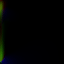

64 64 3


""

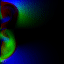

64 64 3


""

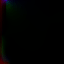

64 64 3


""

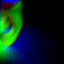

In [5]:
for i in range(4):
  toGif(datasetToFrames(datasets[i]))


In [6]:
alpha = 0.01
lr = 2e-03
lr_sched = tf.keras.optimizers.schedules.PiecewiseConstantDecay([1000], [lr, lr*0.05])
optimizer = tf.keras.optimizers.Adam(lr_sched)
loss_object = tf.keras.losses.MeanSquaredError()

In [7]:
#@title Model { vertical-output: true}
tf.keras.mixed_precision.set_global_policy('float32')

class NNA(tf.keras.Model):

    def __init__(self, n_channels):
        super().__init__()
        self.channel_n = n_channels
        self.alpha = alpha

        self.dmodel = tf.keras.Sequential([
            tf.keras.layers.Conv2D(64, 1, activation=tf.nn.relu, padding='same'),
            tf.keras.layers.Conv2D(self.channel_n, 1, padding='same', activation=None, kernel_initializer=tf.zeros_initializer)
        ])
        self(tf.zeros([1, 3, 3, n_channels],  dtype=tf.float32))

    def perceive(self, x):
        cellID = tf.constant([[0., 0., 0.], [0., 1., 0.], [0., 0., 0.]], dtype=tf.float32)
        sobelX = tf.constant([[-1., 0., 1.], [-2., 0., 2.], [-1., 0., 1.]], dtype=tf.float32)
        sobelY = tf.constant([[-1., -2., -1.], [0., 0., 0.], [1., 2., 1.]], dtype=tf.float32)

        kernel = tf.stack([cellID, sobelX, sobelY], -1)[:, :, None, :]
        kernel = tf.repeat(kernel, self.channel_n, 2)

        y = tf.nn.depthwise_conv2d(x, kernel, [1, 1, 1, 1], 'SAME')
        return y

    def call(self, x, steps = 1 , mask = False):
        if mask:
          pre_live_mask = get_living_mask(x)

        y = self.perceive(x)
        dx = self.dmodel(y) * steps

        update_mask = tf.random.uniform(tf.shape(x[:, :, :, :1])) <= 0.5
        x += dx * tf.cast(update_mask, tf.float32)

        if mask:
          post_life_mask = get_living_mask(x)
          life_mask = pre_live_mask | post_life_mask
          life_mask = mask_edges(life_mask)
          return x * tf.cast(life_mask, tf.float32)

        return x

#model = NNA(4)
#model.summary()

Epoch 0 , Loss 1.0721644163131714


dye,vel,hidden channel

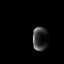
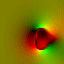
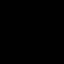

Epoch 80 , Loss 4.057884216308594


dye,vel,hidden channel

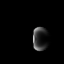
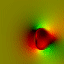
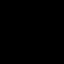

Epoch 160 , Loss 3.1083717346191406


dye,vel,hidden channel

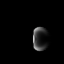
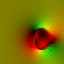
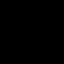

Epoch 240 , Loss 6.948643684387207


dye,vel,hidden channel

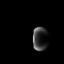
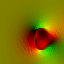
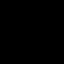

Epoch 320 , Loss 6.2867584228515625


dye,vel,hidden channel

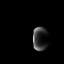
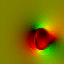
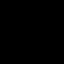

KeyboardInterrupt: ignored

In [ ]:
n_channels = 3
n_hidden_channels = 6
extra_steps = 10
alpha = 0.01
model = NNA(n_channels + n_hidden_channels)

#@title Dye2 : Loss frame + rand init frame + 30 extra steps { vertical-output: true}
def train_step_frame_at_a_time():
    id = np.random.randint(n_datasets)
    dataset = datasets[id]
    n, _, _, _, _ = np.shape(dataset)
    loss = 0
    x = tf.convert_to_tensor(np.concatenate((dataset[0],np.zeros((1,64,64,n_hidden_channels))) , axis = -1))
    with tf.GradientTape() as g:        
        for i in tf.range(n):
          for j in tf.range(extra_steps):
              x = model(x)
        loss += loss_object(dataset[i], rgb_m(x)) * 100
    gradients = g.gradient(loss, model.weights)
    gradients = [g / (tf.norm(g) + 1e-8) for g in gradients]
    optimizer.apply_gradients(zip(gradients, model.weights))
    return x, loss


init = tf.convert_to_tensor(np.concatenate((datasets[0][0], np.zeros((1,64,64,n_hidden_channels))) , axis = -1))

EPOCHS = 501
losses = []
for epoch in range(EPOCHS):
    x, loss = train_step_frame_at_a_time()
    losses.append(loss)
    if epoch % 80 == 0:
      print(f'Epoch {epoch} , Loss {loss}')
      _ = modelToGif(model, init ,50 , channels=3)

plt.plot(losses)
plt.title("Loss per epoch")
plt.show()

In [ ]:
#@title Deep Model, less Kernels { vertical-output: true}
class NNA(tf.keras.Model):

    def __init__(self, n_channels):
        super().__init__()
        self.channel_n = n_channels
        self.alpha = alpha

        self.dmodel = tf.keras.Sequential([
            tf.keras.layers.Conv2D(64, 1, activation=tf.nn.relu, padding='same'),
            tf.keras.layers.Conv2D(32, 1, activation=tf.nn.relu, padding='same'),
            tf.keras.layers.Conv2D(self.channel_n, 1, padding='same', activation=None, kernel_initializer=tf.zeros_initializer)
        ])
        self(tf.zeros([1, 3, 3, n_channels]))

    def perceive(self, x):
        cellID = tf.constant([[0., 0., 0.], [0., 1., 0.], [0., 0., 0.]], dtype=tf.float32)
        sobelX = tf.constant([[-1., 0., 1.], [-2., 0., 2.], [-1., 0., 1.]], dtype=tf.float32)
        sobelY = tf.constant([[-1., -2., -1.], [0., 0., 0.], [1., 2., 1.]], dtype=tf.float32)

        kernel = tf.stack([cellID, sobelX, sobelY], -1)[:, :, None, :]
        kernel = tf.repeat(kernel, self.channel_n, 2)

        y = tf.nn.depthwise_conv2d(x, kernel, [1, 1, 1, 1], 'SAME')
        return y

    def call(self, x, steps = 1 , mask = False):
        if mask:
          pre_live_mask = get_living_mask(x)

        y = self.perceive(x)
        dx = self.dmodel(y) * steps

        update_mask = tf.random.uniform(tf.shape(x[:, :, :, :1])) <= 0.5
        x += dx * tf.cast(update_mask, tf.float32)

        if mask:
          post_life_mask = get_living_mask(x)
          life_mask = pre_live_mask | post_life_mask
          life_mask = mask_edges(life_mask)
          return x * tf.cast(life_mask, tf.float32)

        return x

model = NNA(4)
model.summary()

Model: "nna_32"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_32 (Sequential)  (1, 3, 3, 4)              3044      
                                                                 
Total params: 3,044
Trainable params: 3,044
Non-trainable params: 0
_________________________________________________________________


  0%|          | 0/501 [00:00<?, ?it/s]

Epoch 0 , Loss 5.255290508270264


dye,vel,hidden channel

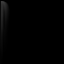
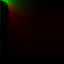
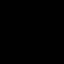

 16%|█▌        | 80/501 [04:27<21:22,  3.05s/it]

Epoch 80 , Loss 3.7755825519561768


dye,vel,hidden channel

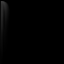
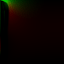
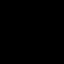

 32%|███▏      | 160/501 [08:47<19:53,  3.50s/it]

Epoch 160 , Loss 6.644664764404297


dye,vel,hidden channel

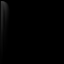
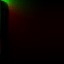
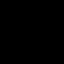

 48%|████▊     | 240/501 [12:59<14:20,  3.30s/it]

Epoch 240 , Loss 5.366690158843994


dye,vel,hidden channel

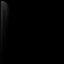
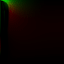
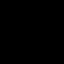

 64%|██████▍   | 320/501 [17:00<08:22,  2.78s/it]

Epoch 320 , Loss 54.522315979003906


dye,vel,hidden channel

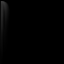
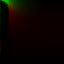
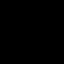

 80%|███████▉  | 400/501 [21:10<06:06,  3.63s/it]

Epoch 400 , Loss 7.735445022583008


dye,vel,hidden channel

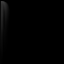
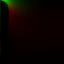
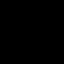

 96%|█████████▌| 480/501 [25:42<01:21,  3.89s/it]

Epoch 480 , Loss 1.7546814680099487


dye,vel,hidden channel

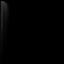
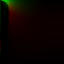
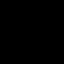

100%|██████████| 501/501 [26:53<00:00,  3.22s/it]


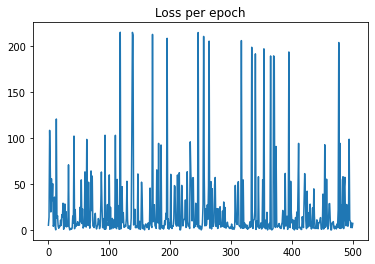

In [ ]:
n_channels = 3
n_hidden_channels = 6
extra_steps = 7
alpha = 0.01
model = NNA(n_channels + n_hidden_channels)

#@title Dye2 : Loss frame + rand init frame + 7 extra steps { vertical-output: true}
def train_step_frame_at_a_time():
    id = np.random.randint(n_datasets)
    dataset = datasets[id]
    n, _, _, _, _ = np.shape(dataset)
    loss = 0
    x = tf.convert_to_tensor(np.concatenate((dataset[0],np.zeros((1,64,64,n_hidden_channels))) , axis = -1))
    with tf.GradientTape() as g:        
        for i in tf.range(n):
          for j in tf.range(extra_steps):
              x = model(x)
          loss += loss_object(dataset[i], rgb_m(x)) * 100
    gradients = g.gradient(loss, model.weights)
    gradients = [g / (tf.norm(g) + 1e-8) for g in gradients]
    optimizer.apply_gradients(zip(gradients, model.weights))
    return x, loss


init = tf.convert_to_tensor(np.concatenate((datasets[0][0], np.zeros((1,64,64,n_hidden_channels))) , axis = -1))

EPOCHS = 501
losses = []
for epoch in tqdm(range(EPOCHS)):
    x, loss = train_step_frame_at_a_time()
    losses.append(loss)
    if epoch % 80 == 0:
      print(f'Epoch {epoch} , Loss {loss}')
      _ = modelToGif(model, init ,200 , channels=3)

plt.plot(losses)
plt.title("Loss per epoch")
plt.show()

In [9]:
#@title Deeper Model, more Kernels { vertical-output: true}
class NNA(tf.keras.Model):

    def __init__(self, n_channels):
        super().__init__()
        self.channel_n = n_channels
        self.alpha = alpha

        self.dmodel = tf.keras.Sequential([
            tf.keras.layers.Conv2D(128, 1, activation=tf.nn.relu, padding='same'),
            tf.keras.layers.Conv2D(128, 1, activation=tf.nn.relu, padding='same'),
            tf.keras.layers.Conv2D(128, 1, activation=tf.nn.relu, padding='same'),
            tf.keras.layers.Conv2D(self.channel_n, 1, padding='same', activation=None, kernel_initializer=tf.zeros_initializer)
        ])
        self(tf.zeros([1, 3, 3, n_channels]))

    def perceive(self, x):
        cellID = tf.constant([[0., 0., 0.], [0., 1., 0.], [0., 0., 0.]], dtype=tf.float32)
        sobelX = tf.constant([[-1., 0., 1.], [-2., 0., 2.], [-1., 0., 1.]], dtype=tf.float32)
        sobelY = tf.constant([[-1., -2., -1.], [0., 0., 0.], [1., 2., 1.]], dtype=tf.float32)

        kernel = tf.stack([cellID, sobelX, sobelY], -1)[:, :, None, :]
        kernel = tf.repeat(kernel, self.channel_n, 2)

        y = tf.nn.depthwise_conv2d(x, kernel, [1, 1, 1, 1], 'SAME')
        return y

    def call(self, x, steps = 1 , mask = False):
        if mask:
          pre_live_mask = get_living_mask(x)

        y = self.perceive(x)
        dx = self.dmodel(y) * steps

        update_mask = tf.random.uniform(tf.shape(x[:, :, :, :1])) <= 0.5
        x += dx * tf.cast(update_mask, tf.float32)

        if mask:
          post_life_mask = get_living_mask(x)
          life_mask = pre_live_mask | post_life_mask
          life_mask = mask_edges(life_mask)
          return x * tf.cast(life_mask, tf.float32)

        return x

model = NNA(4)
model.summary()

Model: "nna_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_1 (Sequential)   (1, 3, 3, 4)              35204     
                                                                 
Total params: 35,204
Trainable params: 35,204
Non-trainable params: 0
_________________________________________________________________


  0%|          | 0/501 [00:00<?, ?it/s]

Epoch 0 , Loss 48.54754638671875


dye,vel,hidden channel

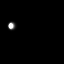
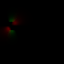
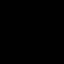

 16%|█▌        | 80/501 [09:21<49:19,  7.03s/it]

Epoch 80 , Loss 46.272281646728516


dye,vel,hidden channel

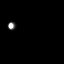
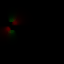
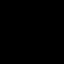

 32%|███▏      | 160/501 [20:30<49:30,  8.71s/it]

Epoch 160 , Loss 7.533769130706787


dye,vel,hidden channel

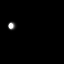
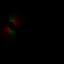
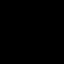

 48%|████▊     | 240/501 [30:47<24:15,  5.58s/it]

Epoch 240 , Loss 30.499549865722656


dye,vel,hidden channel

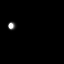
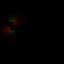
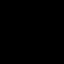

 64%|██████▍   | 320/501 [40:50<29:49,  9.89s/it]

Epoch 320 , Loss 90.34841918945312


dye,vel,hidden channel

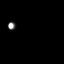
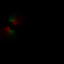
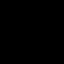

 80%|███████▉  | 400/501 [51:35<14:34,  8.65s/it]

Epoch 400 , Loss 22.988754272460938


dye,vel,hidden channel

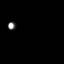
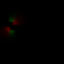
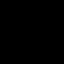

 96%|█████████▌| 480/501 [1:02:39<03:22,  9.62s/it]

Epoch 480 , Loss 34.56939697265625


dye,vel,hidden channel

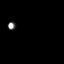
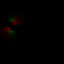
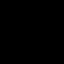

100%|██████████| 501/501 [1:05:34<00:00,  7.85s/it]


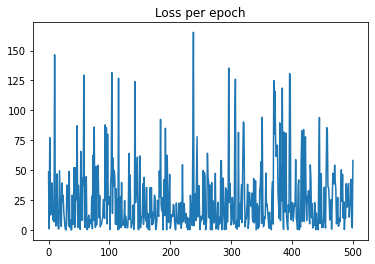

In [ ]:
n_channels = 3
n_hidden_channels = 6
extra_steps = 7
alpha = 0.01
model = NNA(n_channels + n_hidden_channels)

#@title Dye : Loss frame + rand init frame + 7 extra steps { vertical-output: true}
def train_step_frame_at_a_time():
    id = np.random.randint(n_datasets)
    dataset = datasets[id]
    n, _, _, _, _ = np.shape(dataset)
    loss = 0
    x = tf.convert_to_tensor(np.concatenate((dataset[0],np.zeros((1,64,64,n_hidden_channels))) , axis = -1))
    with tf.GradientTape() as g:        
        for i in tf.range(n):
          for j in tf.range(extra_steps):
              x = model(x)
          loss += loss_object(dataset[i], rgb_m(x)) * 100
    gradients = g.gradient(loss, model.weights)
    gradients = [g / (tf.norm(g) + 1e-8) for g in gradients]
    optimizer.apply_gradients(zip(gradients, model.weights))
    return x, loss


init = tf.convert_to_tensor(np.concatenate((datasets[0][0], np.zeros((1,64,64,n_hidden_channels))) , axis = -1))

EPOCHS = 501
losses = []
for epoch in tqdm(range(EPOCHS)):
    x, loss = train_step_frame_at_a_time()
    losses.append(loss)
    if epoch % 80 == 0:
      print(f'Epoch {epoch} , Loss {loss}')
      _ = modelToGif(model, init ,200 , channels=3)

plt.plot(losses)
plt.title("Loss per epoch")
plt.show()

  0%|          | 0/2000 [00:00<?, ?it/s]

Epoch 0 , Loss 13.921503067016602


dye,vel,hidden channel

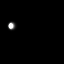
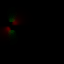
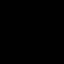

  4%|▍         | 80/2000 [11:01<5:38:21, 10.57s/it]

Epoch 80 , Loss 53.34124755859375


dye,vel,hidden channel

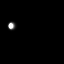
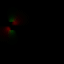
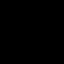

  8%|▊         | 160/2000 [21:32<4:51:10,  9.50s/it]

Epoch 160 , Loss 32.18556594848633


dye,vel,hidden channel

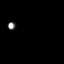
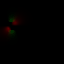
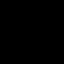

 12%|█▏        | 240/2000 [31:30<3:42:23,  7.58s/it]

Epoch 240 , Loss 49.041290283203125


dye,vel,hidden channel

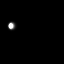
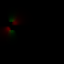
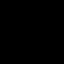

 16%|█▌        | 320/2000 [41:01<2:32:57,  5.46s/it]

Epoch 320 , Loss 15.731688499450684


dye,vel,hidden channel

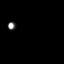
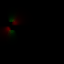
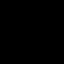

 20%|██        | 400/2000 [50:41<2:24:20,  5.41s/it]

Epoch 400 , Loss 2.372892379760742


dye,vel,hidden channel

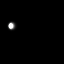
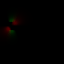
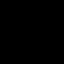

 24%|██▍       | 480/2000 [1:01:37<3:45:10,  8.89s/it]

Epoch 480 , Loss 14.431922912597656


dye,vel,hidden channel

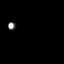
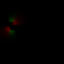
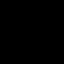

 28%|██▊       | 560/2000 [1:11:25<2:31:36,  6.32s/it]

Epoch 560 , Loss 7.7829508781433105


dye,vel,hidden channel

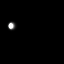
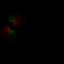
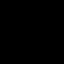

 32%|███▏      | 640/2000 [1:21:58<3:35:26,  9.50s/it]

Epoch 640 , Loss 0.24553905427455902


dye,vel,hidden channel

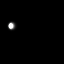
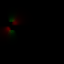
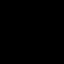

 36%|███▌      | 720/2000 [1:32:00<2:30:29,  7.05s/it]

Epoch 720 , Loss 0.2521830201148987


dye,vel,hidden channel

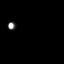
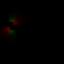
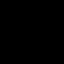

 40%|████      | 800/2000 [1:42:20<1:53:45,  5.69s/it]

Epoch 800 , Loss 5.8726887702941895


dye,vel,hidden channel

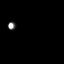
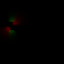
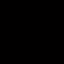

 44%|████▍     | 880/2000 [1:52:38<2:17:21,  7.36s/it]

Epoch 880 , Loss 2.1984663009643555


dye,vel,hidden channel

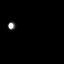
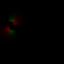
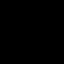

 48%|████▊     | 960/2000 [2:03:29<1:43:51,  5.99s/it]

Epoch 960 , Loss 1.8453266620635986


dye,vel,hidden channel

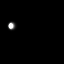
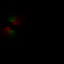
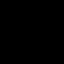

 52%|█████▏    | 1040/2000 [2:13:45<1:41:18,  6.33s/it]

Epoch 1040 , Loss 7.090154647827148


dye,vel,hidden channel

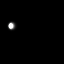
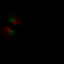
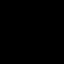

 56%|█████▌    | 1120/2000 [2:23:29<1:50:53,  7.56s/it]

Epoch 1120 , Loss 21.956253051757812


dye,vel,hidden channel

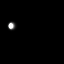
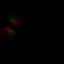
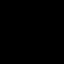

 60%|█████▉    | 1190/2000 [2:32:09<1:43:34,  7.67s/it]


KeyboardInterrupt: ignored

In [ ]:
n_channels = 3
n_hidden_channels = 6
extra_steps = 7
alpha = 0.01
model = NNA(n_channels + n_hidden_channels)

#@title Dye : Loss frame + rand init frame + 7 extra steps { vertical-output: true}
def train_step_frame_at_a_time():
    id = np.random.randint(n_datasets)
    dataset = datasets[id]
    n, _, _, _, _ = np.shape(dataset)
    loss = 0
    x = tf.convert_to_tensor(np.concatenate((dataset[0],np.zeros((1,64,64,n_hidden_channels))) , axis = -1))
    with tf.GradientTape() as g:        
        for i in tf.range(n):
          for j in tf.range(extra_steps):
              x = model(x)
          loss += loss_object(dataset[i], rgb_m(x)) * 100
    gradients = g.gradient(loss, model.weights)
    gradients = [g / (tf.norm(g) + 1e-8) for g in gradients]
    optimizer.apply_gradients(zip(gradients, model.weights))
    return x, loss


init = tf.convert_to_tensor(np.concatenate((datasets[0][0], np.zeros((1,64,64,n_hidden_channels))) , axis = -1))

EPOCHS = 2000
losses = []
for epoch in tqdm(range(EPOCHS)):
    x, loss = train_step_frame_at_a_time()
    losses.append(loss)
    if epoch % 80 == 0:
      print(f'Epoch {epoch} , Loss {loss}')
      _ = modelToGif(model, init ,200 , channels=3)

plt.plot(losses)
plt.title("Loss per epoch")
plt.show()

dye,vel,hidden channel

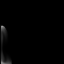
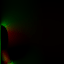
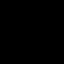

dye,vel,hidden channel

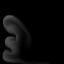
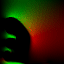
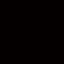

dye,vel,hidden channel

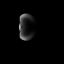
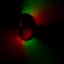
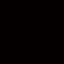

dye,vel,hidden channel

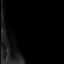
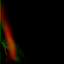
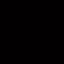

In [ ]:
init = tf.convert_to_tensor(np.concatenate((datasets[1][0], np.zeros((1,64,64,n_hidden_channels))) , axis = -1))

_ = modelToGif(model, init ,600 , channels=3)

init = tf.convert_to_tensor(np.concatenate((datasets[2][0], np.zeros((1,64,64,n_hidden_channels))) , axis = -1))

_ = modelToGif(model, init ,600 , channels=3)


init = tf.convert_to_tensor(np.concatenate((datasets[3][0], np.zeros((1,64,64,n_hidden_channels))) , axis = -1))

_ = modelToGif(model, init ,600 , channels=3)

init = tf.convert_to_tensor(np.concatenate((datasets[4][0], np.zeros((1,64,64,n_hidden_channels))) , axis = -1))

_ = modelToGif(model, init ,600 , channels=3)

  0%|          | 0/2000 [00:00<?, ?it/s]

Epoch 0 , Loss 0.02310657501220703


dye,vel,hidden channel

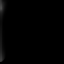
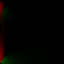
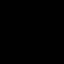

  4%|▍         | 80/2000 [00:55<10:21,  3.09it/s]

Epoch 80 , Loss 91.44603729248047


dye,vel,hidden channel

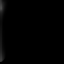
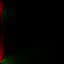
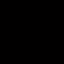

  8%|▊         | 160/2000 [01:52<20:31,  1.49it/s]

Epoch 160 , Loss 0.49508875608444214


dye,vel,hidden channel

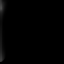
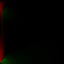
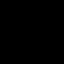

 12%|█▏        | 240/2000 [03:02<17:02,  1.72it/s]

Epoch 240 , Loss 65.53376770019531


dye,vel,hidden channel

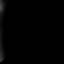
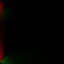
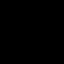

 16%|█▌        | 320/2000 [03:56<16:34,  1.69it/s]

Epoch 320 , Loss 1.56736159324646


dye,vel,hidden channel

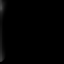
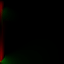
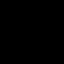

 20%|██        | 400/2000 [05:07<27:11,  1.02s/it]

Epoch 400 , Loss 40.318267822265625


dye,vel,hidden channel

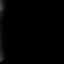
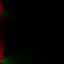
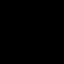

 24%|██▍       | 479/2000 [06:01<16:11,  1.57it/s]

Epoch 480 , Loss 0.001650868565775454


dye,vel,hidden channel

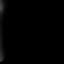
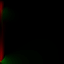
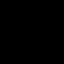

 28%|██▊       | 560/2000 [07:00<13:35,  1.76it/s]

Epoch 560 , Loss 22.02731704711914


dye,vel,hidden channel

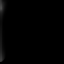
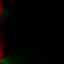
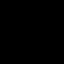

 29%|██▊       | 574/2000 [07:15<18:01,  1.32it/s]


KeyboardInterrupt: ignored

In [12]:
n_channels = 3
n_hidden_channels = 6
extra_steps = 1
alpha = 0.01
model = NNA(n_channels + n_hidden_channels)

#@title Dye : Loss frame + rand init frame + 7 extra steps { vertical-output: true}
def train_step_frame_at_a_time():
    id = np.random.randint(n_datasets)
    dataset = datasets[id]
    n, _, _, _, _ = np.shape(dataset)
    n = np.random.randint(1,n)
    loss = 0
    x = tf.convert_to_tensor(np.concatenate((dataset[0],np.zeros((1,64,64,n_hidden_channels))) , axis = -1))
    with tf.GradientTape() as g:        
        for i in tf.range(n):
          for j in tf.range(extra_steps):
              x = model(x)
          loss += loss_object(dataset[i], rgb_m(x)) * 100
    gradients = g.gradient(loss, model.weights)
    gradients = [g / (tf.norm(g) + 1e-8) for g in gradients]
    optimizer.apply_gradients(zip(gradients, model.weights))
    return x, loss


init = tf.convert_to_tensor(np.concatenate((datasets[0][0], np.zeros((1,64,64,n_hidden_channels))) , axis = -1))

EPOCHS = 2000
losses = []
for epoch in tqdm(range(EPOCHS)):
    x, loss = train_step_frame_at_a_time()
    losses.append(loss)
    if epoch % 80 == 0:
      print(f'Epoch {epoch} , Loss {loss}')
      _ = modelToGif(model, init ,200 , channels=3)

plt.plot(losses)
plt.title("Loss per epoch")
plt.show()

dye,vel,hidden channel

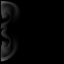
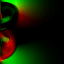
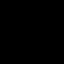

dye,vel,hidden channel

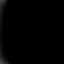
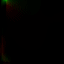
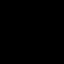

dye,vel,hidden channel

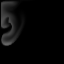
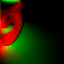
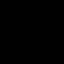

dye,vel,hidden channel

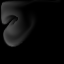
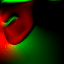
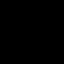

In [14]:
init = tf.convert_to_tensor(np.concatenate((datasets[1][0], np.zeros((1,64,64,n_hidden_channels))) , axis = -1))

_ = modelToGif(model, init ,300 , channels=3)

init = tf.convert_to_tensor(np.concatenate((datasets[2][0], np.zeros((1,64,64,n_hidden_channels))) , axis = -1))

_ = modelToGif(model, init ,300 , channels=3)


init = tf.convert_to_tensor(np.concatenate((datasets[3][0], np.zeros((1,64,64,n_hidden_channels))) , axis = -1))

_ = modelToGif(model, init ,300 , channels=3)

init = tf.convert_to_tensor(np.concatenate((datasets[4][0], np.zeros((1,64,64,n_hidden_channels))) , axis = -1))

_ = modelToGif(model, init ,300 , channels=3)

In [25]:
#@title Deeper Model, more Kernels { vertical-output: true}
class NNA(tf.keras.Model):

    def __init__(self, n_channels):
        super().__init__()
        self.channel_n = n_channels
        self.alpha = alpha

        self.dmodel = tf.keras.Sequential([
            tf.keras.layers.Conv2D(128, 3, activation=tf.nn.relu, padding='same'),
            tf.keras.layers.Conv2D(128, 1, activation=tf.nn.relu, padding='same'),
            tf.keras.layers.Conv2D(128, 1, activation=tf.nn.relu, padding='same'),
            tf.keras.layers.Conv2D(self.channel_n, 1, padding='same', activation=None, kernel_initializer=tf.zeros_initializer)
        ])
        self(tf.zeros([1, 3, 3, n_channels]))

    def perceive(self, x):
        cellID = tf.constant([[0., 0., 0.], [0., 1., 0.], [0., 0., 0.]], dtype=tf.float32)
        sobelX = tf.constant([[-1., 0., 1.], [-2., 0., 2.], [-1., 0., 1.]], dtype=tf.float32)
        sobelY = tf.constant([[-1., -2., -1.], [0., 0., 0.], [1., 2., 1.]], dtype=tf.float32)

        kernel = tf.stack([cellID, sobelX, sobelY], -1)[:, :, None, :]
        kernel = tf.repeat(kernel, self.channel_n, 2)

        y = tf.nn.depthwise_conv2d(x, kernel, [1, 1, 1, 1], 'SAME')
        return y

    def call(self, x, steps = 1 , mask = False):
        if mask:
          pre_live_mask = get_living_mask(x)

        y = self.perceive(x)
        dx = self.dmodel(y) * steps

        update_mask = tf.random.uniform(tf.shape(x[:, :, :, :1])) <= 0.5
        x += dx * tf.cast(update_mask, tf.float32)

        if mask:
          post_life_mask = get_living_mask(x)
          life_mask = pre_live_mask | post_life_mask
          life_mask = mask_edges(life_mask)
          return x * tf.cast(life_mask, tf.float32)

        return x

model = NNA(4)
model.summary()

Model: "nna_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_12 (Sequential)  (1, 3, 3, 4)              47492     
                                                                 
Total params: 47,492
Trainable params: 47,492
Non-trainable params: 0
_________________________________________________________________


In [26]:
def add_noise(frame, n_hidden_channels, level = 0.1):
  _, _, _, c = np.shape(frame)
  noise = (np.random.random((64, 64, c))-0.5)  * level
  noise = np.expand_dims(noise, 0)
  channels = np.concatenate((frame + noise ,np.ones((1,64,64,n_hidden_channels))), axis = -1)
  x = tf.cast(tf.convert_to_tensor(channels),tf.float32)
  return x

  0%|          | 0/2000 [00:00<?, ?it/s]

Epoch 0 , Loss 0.04358941316604614


dye,vel,hidden channel

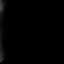
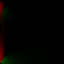
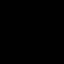

  3%|▎         | 54/2000 [00:57<41:37,  1.28s/it]

In [ ]:
n_channels = 3
n_hidden_channels = 6
extra_steps = 1
alpha = 0.01
model = NNA(n_channels + n_hidden_channels)

#@title Dye : Loss frame + rand init frame + no extra steps + larger kernel { vertical-output: true}
def train_step_frame_at_a_time():
    id = np.random.randint(n_datasets)
    dataset = datasets[id]
    n, _, _, _, _ = np.shape(dataset)
    n = np.random.randint(1,n)
    loss = 0
    x = tf.convert_to_tensor(np.concatenate((dataset[0],np.zeros((1,64,64,n_hidden_channels))) , axis = -1))
    with tf.GradientTape() as g:        
        for i in tf.range(n):
          for j in tf.range(extra_steps):
              x = model(x)
          loss += loss_object(dataset[i], rgb_m(x)) * 100 * float(i)
    gradients = g.gradient(loss, model.weights)
    gradients = [g / (tf.norm(g) + 1e-8) for g in gradients]
    optimizer.apply_gradients(zip(gradients, model.weights))
    return x, loss


init = tf.convert_to_tensor(np.concatenate((datasets[0][0], np.zeros((1,64,64,n_hidden_channels))) , axis = -1))

EPOCHS = 2000
losses = []
for epoch in tqdm(range(EPOCHS)):
    x, loss = train_step_frame_at_a_time()
    losses.append(loss)
    if epoch % 80 == 0:
      print(f'Epoch {epoch} , Loss {loss}')
      _ = modelToGif(model, init ,200 , channels=3)

plt.plot(losses)
plt.title("Loss per epoch")
plt.show()